# Multi-reflection BCDI: reconstruction notebook
## Compact crystal with single screw dislocation


In [ ]:
import sys

sys.path.insert( 0, '../src' )

In [1]:
import numpy as np
import h5py as h5

from logzero import logger
import matplotlib.pyplot as plt
import TilePlot as tp
from torch.fft import fftshift as fftshift_t, fftn as fftn_t
from numpy.fft import fftshift as fftshift_o, fftn as fftn_o, ifftn as ifftn_o


import MultiReflectionSolver.MultiReflectionSolver as mrbcdi

In [2]:
# %matplotlib notebook
%matplotlib inline

In [3]:
datafile = '../data/Au_Twodisloc.h5'
resultfile = 'Results_screwdisloc_restricted_2.h5'

In [4]:
optim_plan = { 
    'minibatches': [ 800, 400, 320, 240, 160, 80, 40, 20, 1 ], 
    'minibatch_size': [ 2, 2, 2, 3, 3, 3, 3, 3, 4 ],
    'iterations_per_minibatch': [ 3, 6, 12, 25, 50, 100, 200, 400, 2000 ]
}

In [5]:
logger.info( 'Loading grain data into solver. ' )
data = h5.File( datafile, 'r' )
logger.info( 'Printing data tree...' )
data.visit( print )
solver = MultiReflectionSolver( 
    database=data, 
    signal_label='signal/photon_max_100000.0', 
    sigma=3.3, 
    learning_rate=1.e-2,
    activation_parameter=1., 
    medfilter_kernel=7, 
    minibatch_plan=optim_plan, 
    lambda_tv=1.e-6
)
logger.info( 'Created solver. ' )
logger.info( 'Successful scans: %s'%str( data[ 'scans' ].attrs[ 'successful_scans' ] ) )
    
logger.info( 'Global parameters: ' )
for key, value in solver.globals.items():
    logger.info( '\t%s: %s'%( key, value ) )

[I 220609 13:18:31 <ipython-input-5-0177aa659bb0>:1] Loading grain data into solver. 
[I 220609 13:18:31 <ipython-input-5-0177aa659bb0>:4] Printing data tree...


global
global/mask
global/ux
global/uy
global/uz
scans
scans/dataset_12
scans/dataset_12/intensity
scans/dataset_12/object
scans/dataset_12/signal
scans/dataset_12/signal/photon_max_10000.0
scans/dataset_12/signal/photon_max_100000.0
scans/dataset_12/signal/photon_max_1000000.0
scans/dataset_12/wave
scans/dataset_17
scans/dataset_17/intensity
scans/dataset_17/object
scans/dataset_17/signal
scans/dataset_17/signal/photon_max_10000.0
scans/dataset_17/signal/photon_max_100000.0
scans/dataset_17/signal/photon_max_1000000.0
scans/dataset_17/wave
scans/dataset_20
scans/dataset_20/intensity
scans/dataset_20/object
scans/dataset_20/signal
scans/dataset_20/signal/photon_max_10000.0
scans/dataset_20/signal/photon_max_100000.0
scans/dataset_20/signal/photon_max_1000000.0
scans/dataset_20/wave
scans/dataset_4
scans/dataset_4/intensity
scans/dataset_4/object
scans/dataset_4/signal
scans/dataset_4/signal/photon_max_10000.0
scans/dataset_4/signal/photon_max_100000.0
scans/dataset_4/signal/photon_max_

[I 220609 13:19:07 <ipython-input-5-0177aa659bb0>:16] Created solver. 
[I 220609 13:19:07 <ipython-input-5-0177aa659bb0>:17] Successful scans: [ 4 12 17 20]
[I 220609 13:19:07 <ipython-input-5-0177aa659bb0>:19] Global parameters: 
[I 220609 13:19:07 <ipython-input-5-0177aa659bb0>:21] 	Rcryst: [[-0.93903183  0.33684613 -0.0689486 ]
     [-0.19505786 -0.68703819 -0.69995068]
     [-0.283146   -0.643827    0.71085521]]
[I 220609 13:19:07 <ipython-input-5-0177aa659bb0>:21] 	arm: 0.638
[I 220609 13:19:07 <ipython-input-5-0177aa659bb0>:21] 	idx: [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24]
[I 220609 13:19:07 <ipython-input-5-0177aa659bb0>:21] 	lam: 1.3785e-11
[I 220609 13:19:07 <ipython-input-5-0177aa659bb0>:21] 	lattice_parms: [ 4.078  4.078  4.078 90.    90.    90.   ]
[I 220609 13:19:07 <ipython-input-5-0177aa659bb0>:21] 	pix: 5.5e-05
[I 220609 13:19:07 <ipython-input-5-0177aa659bb0>:21] 	step_cubic: 12.425694749856257


In [6]:
logger.info( 'Running optimizer...' )
solver.run()

[I 220609 13:19:07 <ipython-input-6-91b907a542b2>:1] Running optimizer...


Epoch          :   0%|          | 0/9 [00:00<?, ?it/s]

Batch/minibatch:   0%|          | 0/800 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/3 [00:00<?, ?it/s]

Batch/minibatch:   0%|          | 0/400 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Batch/minibatch:   0%|          | 0/320 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Batch/minibatch:   0%|          | 0/240 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Batch/minibatch:   0%|          | 0/160 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Batch/minibatch:   0%|          | 0/80 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Batch/minibatch:   0%|          | 0/40 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/200 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/200 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/200 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/200 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/200 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/200 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/200 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/200 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/200 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/200 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/200 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/200 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/200 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/200 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/200 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/200 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/200 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/200 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/200 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/200 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/200 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/200 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/200 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/200 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/200 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/200 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/200 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/200 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/200 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/200 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/200 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/200 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/200 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/200 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/200 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/200 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/200 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/200 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/200 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/200 [00:00<?, ?it/s]

Batch/minibatch:   0%|          | 0/20 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/400 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/400 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/400 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/400 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/400 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/400 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/400 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/400 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/400 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/400 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/400 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/400 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/400 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/400 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/400 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/400 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/400 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/400 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/400 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/400 [00:00<?, ?it/s]

Batch/minibatch:   0%|          | 0/1 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/2000 [00:00<?, ?it/s]

Text(0.5, 1.0, 'Objective function (Poisson-stabilized)')

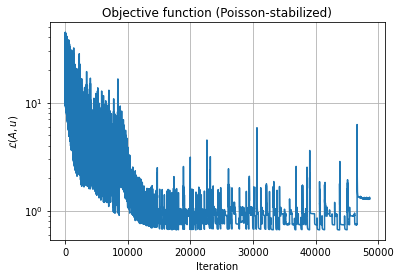

In [7]:
plt.figure()
plt.semilogy( solver.error )
plt.xlabel( 'Iteration' )
plt.ylabel( '$\mathcal{L}(A, u)$')
plt.grid()
plt.title( 'Objective function (Poisson-stabilized)')

In [8]:
new_plan = { 
    'minibatches': [ 1 ], 
    'minibatch_size': [ 4 ],
    'iterations_per_minibatch': [ 5000 ]
}

In [9]:
# solver.centerObject()
solver.setUpRestrictedOptimization( new_plan=new_plan, amp_threshold=0.2, learning_rate=1.e-4, lambda_tv=1.e-5, median_filter=True )
logger.info( 'Running optimizer...' )
solver.run()

[I 220609 16:43:11 <ipython-input-9-990417748bc6>:3] Running optimizer...


Epoch          :   0%|          | 0/1 [00:00<?, ?it/s]

Batch/minibatch:   0%|          | 0/1 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/5000 [00:00<?, ?it/s]

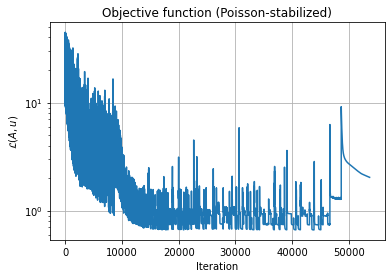

In [10]:
fig = plt.figure()
plt.semilogy( solver.error )
plt.xlabel( 'Iteration' )
plt.ylabel( '$\mathcal{L}(A, u)$')
plt.grid()
plt.title( 'Objective function (Poisson-stabilized)')
fig.canvas.draw()

In [11]:
__u__ = solver.x[solver.N:(4*solver.N) ].reshape( 3, -1 )

In [12]:
amp = solver.__amp__.reshape( 
    *( solver.cubeSize for n in range( 3 ) ) 
).detach().cpu()
u_recon = __u__.detach().cpu()

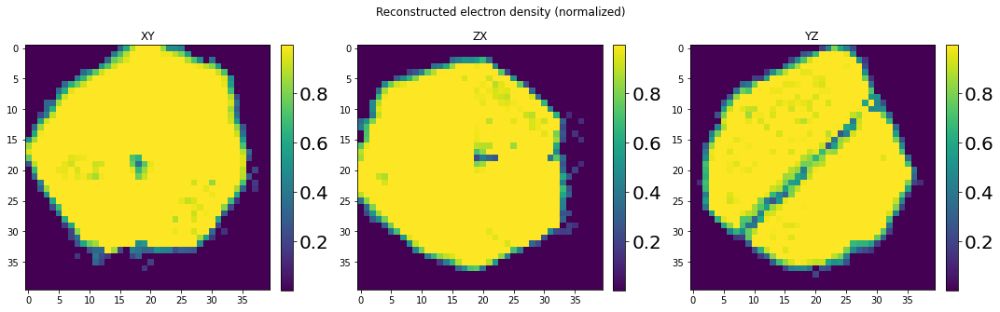

In [13]:
fig, im, ax = tp.TilePlot( 
    tuple( np.transpose( amp, np.roll( [ 0, 1, 2 ], n ) )[:,:,solver.cubeSize//2] for n in range( 3 ) ), 
    ( 1, 3 ), 
    ( 15, 5 )
)
fig.suptitle( 'Reconstructed electron density (normalized)' )
for n, st in enumerate( [ 'XY', 'ZX', 'YZ' ] ):
    ax[n].set_title( st )
    
fig.canvas.draw()

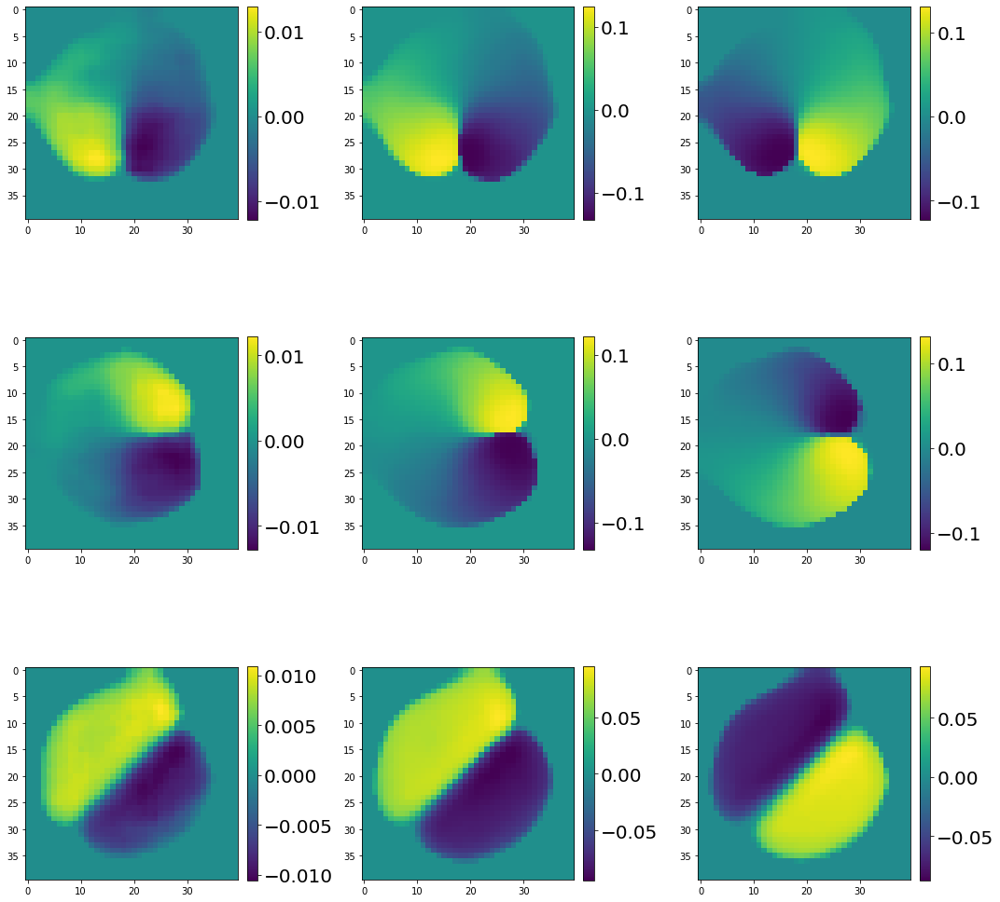

In [14]:
fig, im, ax = tp.TilePlot( 
    tuple( 
        np.transpose( arr.reshape( 40, 40, 40 ), np.roll( [ 0, 1, 2 ], n ) )[:,:,solver.cubeSize//2] 
        for n in range( 3 )
        for arr in u_recon
    ), 
    ( 3, 3 ), 
    ( 15, 15 )
)
fig.canvas.draw()

In [15]:
data.close()

In [16]:
with h5.File( resultfile, 'w' ) as res: 
    
    res.create_group( 'real_space' )
    
    res[ 'real_space' ].create_dataset( 'reconst_state', data=solver.x.detach().cpu().numpy() )
    res[ 'real_space' ].create_dataset( 'electron_density', data=amp )
    res[ 'real_space' ].create_dataset( 'lattice_deformation', data=u_recon )
    res[ 'real_space' ].attrs[ 'scale' ] = list( 
        solver.x[-len(solver.bragg_condition):].detach().cpu().numpy() 
    )
    
    res.create_dataset( 'reconstruction_error', data=solver.error )
    
    res.create_group( 'reciprocal_space' )
    res[ 'reciprocal_space' ].attrs[ 'scan_names' ] = solver.scan_list
    for n, scan in enumerate( [ st.replace( 'scans/', '' ) for st in solver.scan_list ] ):
        print( n, scan )
        obj = solver.getObjectInMount( n )
        fobj = fftshift_t( fftn_t( obj ) ).detach().cpu().numpy()
        res[ 'reciprocal_space' ].create_group( scan )
        res[ 'reciprocal_space/%s'%scan ].create_dataset( 'wave', data=fobj )
        res[ 'reciprocal_space/%s'%scan ].create_dataset( 'data', data=fftshift_o( solver.bragg_condition[n][ 'data' ].detach().cpu().numpy() ) )
    
# end writing result file. 

0 dataset_4
1 dataset_12
2 dataset_17
3 dataset_20


In [17]:
res = h5.File( resultfile, 'r' )

(<Figure size 864x864 with 12 Axes>,
 [<AxesSubplot:>,
  <AxesSubplot:>,
  <AxesSubplot:>,
  <AxesSubplot:>,
  <AxesSubplot:>,
  <AxesSubplot:>])

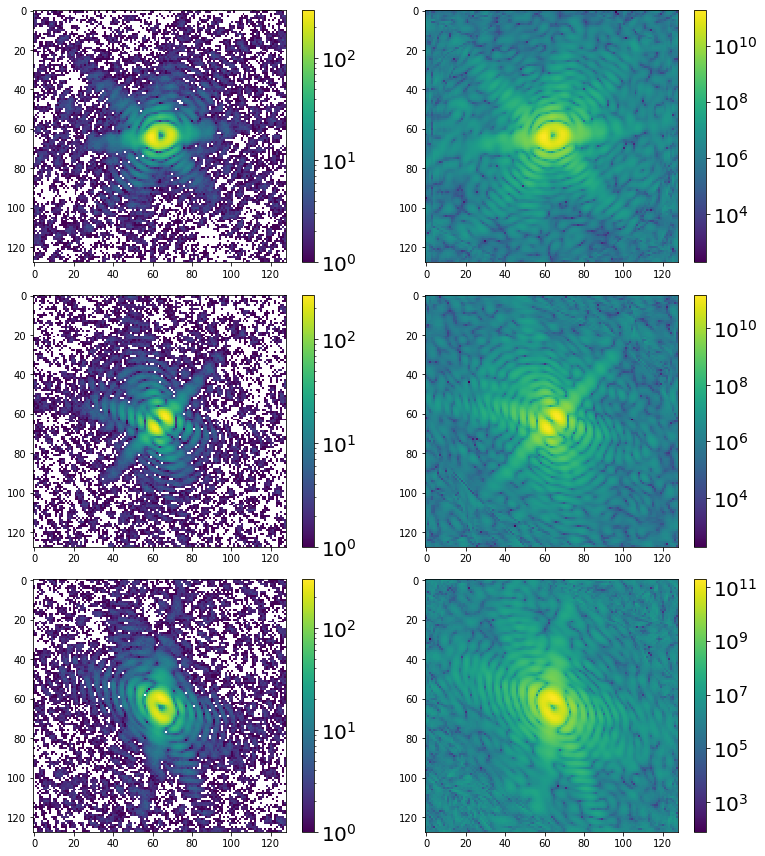

In [18]:
n = 20
st = 'reciprocal_space/dataset_%d'%n
tp.TilePlot( 
    tuple( 
        np.transpose( arr, np.roll( [ 0, 1, 2], n  ) )[:,:,64]
        for n in range( 3 )
        for arr in ( res[ '%s/data'%st ], np.absolute( res[ '%s/wave'%st ] )**2 )
    ),
    ( 3, 2 ), 
    ( 12, 12 ), 
    log_norm=True
)

In [19]:
res.close()